<a href="https://colab.research.google.com/github/drshahizan/Python_EDA/blob/main/assignment/hpdp/DEADPOOL%20/case_study2b/cs2b.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Case Study 2: Automated EDA Tools


Automated EDA Tool used in this case study is AutoViz

## Importing the dataset



### Import the necessary libraries

In [3]:
!pip install pandas
!pip install numpy

import pandas as pd
import numpy as np

### Mount Google Drive with Colab to retrieve dataset


---



In [10]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Assign the dataset to path and read it using panda function and display the data


In [12]:
path = "/content/drive/MyDrive/Colab Notebooks/dataset/donations_state.csv"
data = pd.read_csv(path)
data


,date,state,daily,blood_a,blood_b,blood_o,blood_ab,location_centre,location_mobile,type_wholeblood,type_apheresis_platelet,type_apheresis_plasma,type_other,social_civilian,social_student,social_policearmy,donations_new,donations_regular,donations_irregular
0,2006-01-01,Malaysia,525,152,139,194,40,308,217,525,0,0,0,496,18,11,243,277,5
1,2006-01-02,Malaysia,227,53,43,112,19,162,65,217,6,4,0,224,2,1,83,143,1
2,2006-01-03,Malaysia,112,29,21,56,6,112,0,89,10,13,0,105,2,5,8,101,3
3,2006-01-04,Malaysia,391,92,98,165,36,145,246,371,4,16,0,316,71,4,286,102,3
4,2006-01-05,Malaysia,582,149,198,193,42,371,211,548,17,17,0,555,19,8,328,250,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91247,2023-11-01,W.P. Kuala Lumpur,776,198,225,342,11,88,688,753,10,13,0,443,328,5,284,373,119
91248,2023-11-02,W.P. Kuala Lumpur,591,169,146,262,14,115,476,569,11,11,0,375,210,6,212,271,108
91249,2023-11-03,W.P. Kuala Lumpur,194,54,53,85,2,79,115,177,10,7,0,165,21,8,17,146,31
91250,2023-11-04,W.P. Kuala Lumpur,739,203,212,311,13,151,588,703,14,22,0,571,161,7,163,486,90


## Data Preperation


### Display first 5 rows

In [16]:
data.head()

,date,state,daily,blood_a,blood_b,blood_o,blood_ab,location_centre,location_mobile,type_wholeblood,type_apheresis_platelet,type_apheresis_plasma,type_other,social_civilian,social_student,social_policearmy,donations_new,donations_regular,donations_irregular
0,2006-01-01,Malaysia,525,152,139,194,40,308,217,525,0,0,0,496,18,11,243,277,5
1,2006-01-02,Malaysia,227,53,43,112,19,162,65,217,6,4,0,224,2,1,83,143,1
2,2006-01-03,Malaysia,112,29,21,56,6,112,0,89,10,13,0,105,2,5,8,101,3
3,2006-01-04,Malaysia,391,92,98,165,36,145,246,371,4,16,0,316,71,4,286,102,3
4,2006-01-05,Malaysia,582,149,198,193,42,371,211,548,17,17,0,555,19,8,328,250,4


### Check if NaN exist

In [17]:
data.isnull().sum(axis=0)



date                       0
state                      0
daily                      0
blood_a                    0
blood_b                    0
blood_o                    0
blood_ab                   0
location_centre            0
location_mobile            0
type_wholeblood            0
type_apheresis_platelet    0
type_apheresis_plasma      0
type_other                 0
social_civilian            0
social_student             0
social_policearmy          0
donations_new              0
donations_regular          0
donations_irregular        0
dtype: int64

### Remove duplicates rows from the dataset

In [20]:
data = data.drop_duplicates()
data



,date,state,daily,blood_a,blood_b,blood_o,blood_ab,location_centre,location_mobile,type_wholeblood,type_apheresis_platelet,type_apheresis_plasma,type_other,social_civilian,social_student,social_policearmy,donations_new,donations_regular,donations_irregular
0,2006-01-01,Malaysia,525,152,139,194,40,308,217,525,0,0,0,496,18,11,243,277,5
1,2006-01-02,Malaysia,227,53,43,112,19,162,65,217,6,4,0,224,2,1,83,143,1
2,2006-01-03,Malaysia,112,29,21,56,6,112,0,89,10,13,0,105,2,5,8,101,3
3,2006-01-04,Malaysia,391,92,98,165,36,145,246,371,4,16,0,316,71,4,286,102,3
4,2006-01-05,Malaysia,582,149,198,193,42,371,211,548,17,17,0,555,19,8,328,250,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91247,2023-11-01,W.P. Kuala Lumpur,776,198,225,342,11,88,688,753,10,13,0,443,328,5,284,373,119
91248,2023-11-02,W.P. Kuala Lumpur,591,169,146,262,14,115,476,569,11,11,0,375,210,6,212,271,108
91249,2023-11-03,W.P. Kuala Lumpur,194,54,53,85,2,79,115,177,10,7,0,165,21,8,17,146,31
91250,2023-11-04,W.P. Kuala Lumpur,739,203,212,311,13,151,588,703,14,22,0,571,161,7,163,486,90


## Implementation of Automated EDA Tools

### Tool Installation

---



#### Install AutoViz

In [21]:
!pip install autoviz


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.5/18.5 MB 51.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 358.9/358.9 kB 25.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 55.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 59.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 74.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.3/87.3 kB 8.8 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of panel to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.4/20.4 MB 61.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.1/20.1 MB 69.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 19.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.

#### Import libraries

In [22]:
from autoviz.AutoViz_Class import AutoViz_Class


Imported v0.1.731. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


### a. How to load the dataset into the tool.


---


  * Importing dataset into AutoViz is basically the same step that we used when we first import the dataset. Importing pandas, mount Google Drive and assign the dataset. Hence, there is no need to load the dataset again.



### b. How to generate basic statistics and visualizations.


---



#### Create an AutoViz class instance

In [36]:
AV = AutoViz_Class()
%matplotlib inline


#### Automate Visualization using the class instance

Shape of your Data Set loaded: (91252, 19)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    19 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
To fix data quality issues automatically, import FixDQ from autoviz...


,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
date,object,0.000000,7,nan,nan,"6518 rare categories: Too many to list. Group them into a single category or drop the categories., high cardinality with 6518 unique values: Use hash encoding or embedding to reduce dimension."
state,object,0.000000,0,nan,nan,No issue
daily,int64,0.000000,2,0.000000,5543.000000,has 11800 outliers greater than upper bound (313.00) or lower than lower bound(-159.00). Cap them or remove them.
blood_a,int64,0.000000,0,0.000000,1368.000000,"has 11766 outliers greater than upper bound (79.00) or lower than lower bound(-41.00). Cap them or remove them., has a high correlation with ['daily']. Consider dropping one of them."
blood_b,int64,0.000000,0,0.000000,1601.000000,"has 11633 outliers greater than upper bound (87.50) or lower than lower bound(-44.50). Cap them or remove them., has a high correlation with ['daily', 'blood_a']. Consider dropping one of them."
blood_o,int64,0.000000,1,0.000000,2182.000000,"has 11710 outliers greater than upper bound (132.00) or lower than lower bound(-68.00). Cap them or remove them., has a high correlation with ['daily', 'blood_a', 'blood_b']. Consider dropping one of them."
blood_ab,int64,0.000000,0,0.000000,392.000000,"has 11319 outliers greater than upper bound (21.00) or lower than lower bound(-11.00). Cap them or remove them., has a high correlation with ['daily', 'blood_a', 'blood_b', 'blood_o']. Consider dropping one of them."
location_centre,int64,0.000000,1,0.000000,4674.000000,"has 8760 outliers greater than upper bound (211.50) or lower than lower bound(-112.50). Cap them or remove them., has a high correlation with ['daily', 'blood_a', 'blood_b', 'blood_o', 'blood_ab']. Consider dropping one of them."
location_mobile,int64,0.000000,1,0.000000,3975.000000,"has 15877 outliers greater than upper bound (97.50) or lower than lower bound(-58.50). Cap them or remove them., has a high correlation with ['daily', 'blood_a', 'blood_b', 'blood_o', 'blood_ab']. Consider dropping one of them."
type_wholeblood,int64,0.000000,2,0.000000,5514.000000,"has 11667 outliers greater than upper bound (308.00) or lower than lower bound(-156.00). Cap them or remove them., has a high correlation with ['daily', 'blood_a', 'blood_b', 'blood_o', 'blood_ab', 'location_centre', 'location_mobile']. Consider dropping one of them."


Number of All Scatter Plots = 153


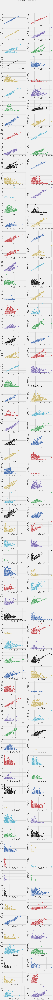

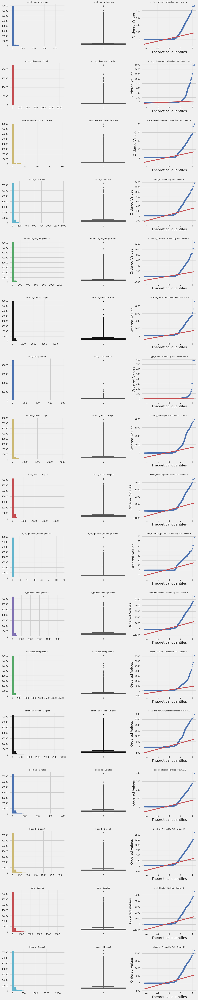

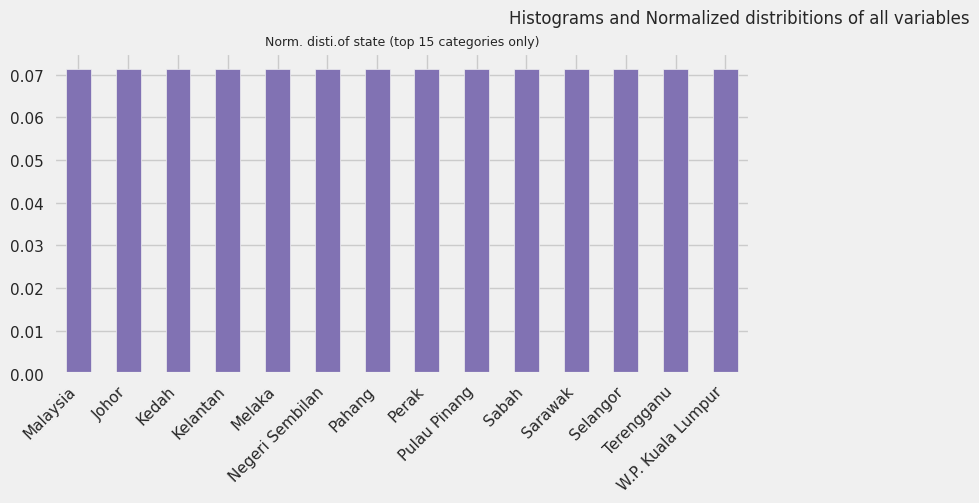

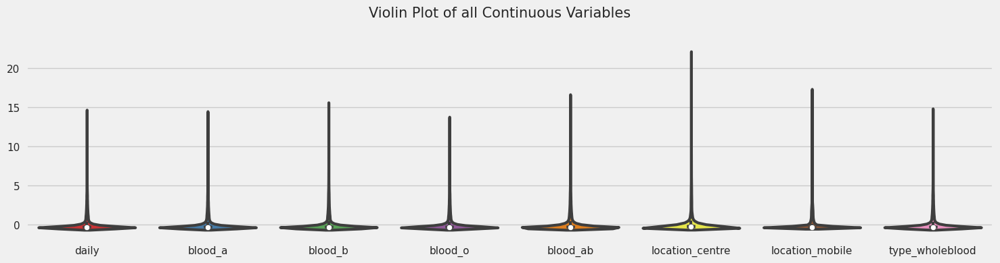

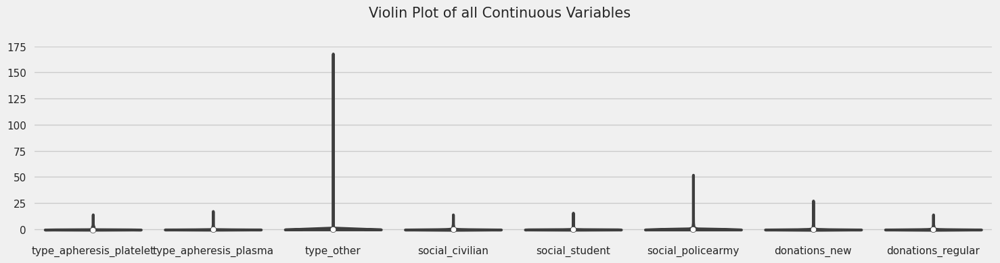

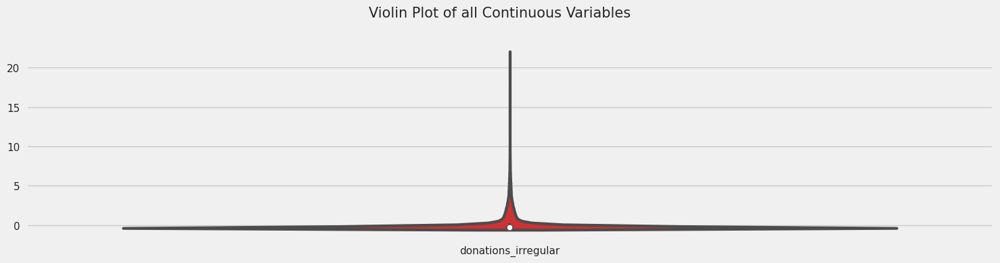

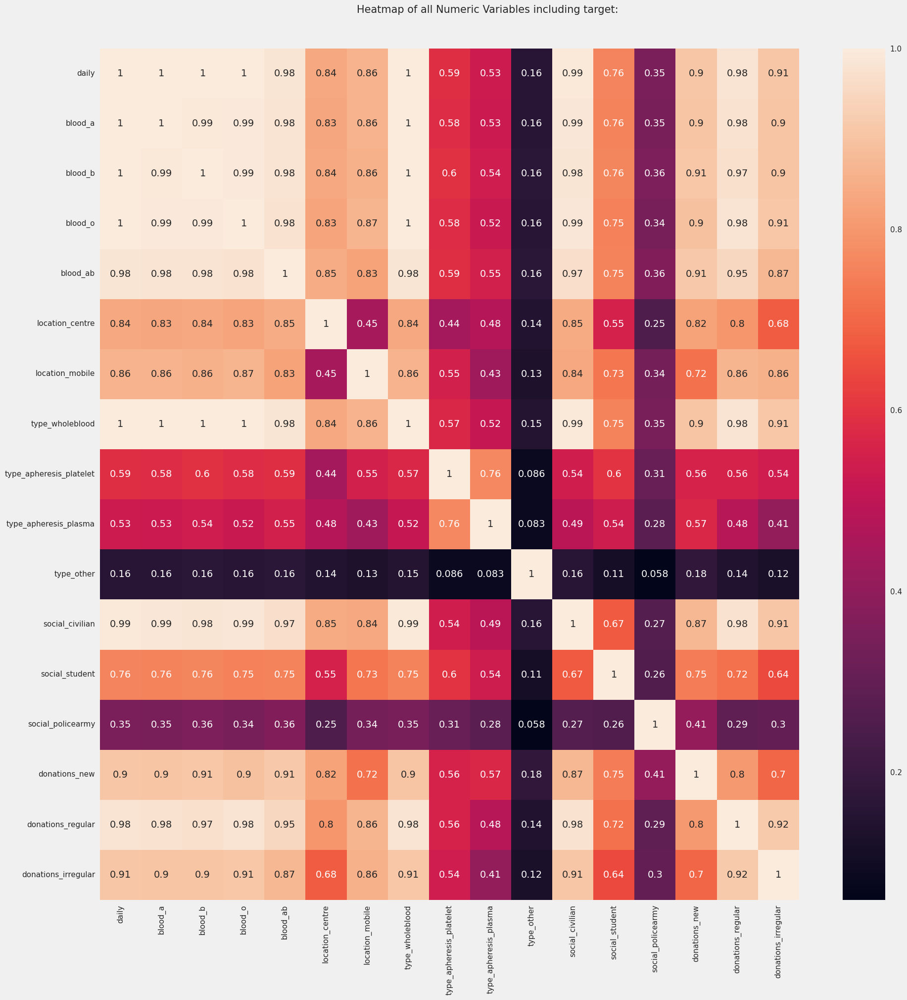

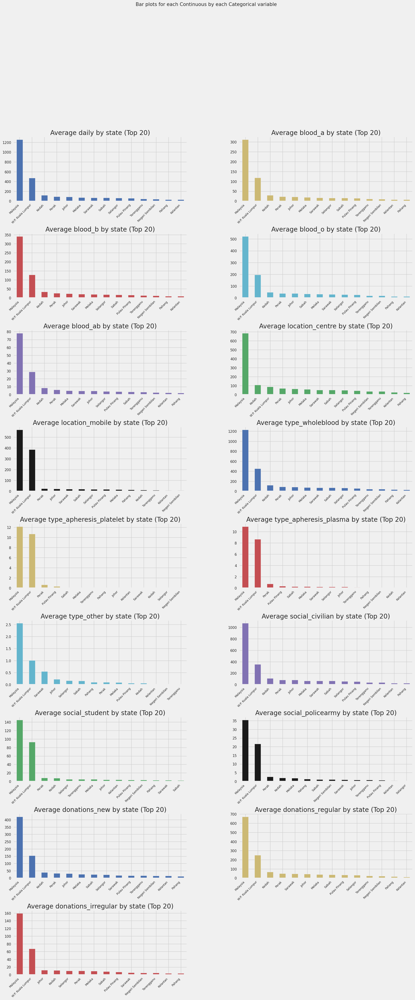

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to /root/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to /root/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to /root/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to /root/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to /root/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Package movie_reviews is already up-to-date!
[nltk_data]    | Downloading package names to /root/nltk_data...
[nltk_data]    |   Package names is already up-to-date!
[nltk_data]    | Do

Could not draw wordcloud plot for date
All Plots done
Time to run AutoViz = 156 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


,date,state,daily,blood_a,blood_b,blood_o,blood_ab,location_centre,location_mobile,type_wholeblood,type_apheresis_platelet,type_apheresis_plasma,type_other,social_civilian,social_student,social_policearmy,donations_new,donations_regular,donations_irregular
0,2006-01-01,Malaysia,525,152,139,194,40,308,217,525,0,0,0,496,18,11,243,277,5
1,2006-01-02,Malaysia,227,53,43,112,19,162,65,217,6,4,0,224,2,1,83,143,1
2,2006-01-03,Malaysia,112,29,21,56,6,112,0,89,10,13,0,105,2,5,8,101,3
3,2006-01-04,Malaysia,391,92,98,165,36,145,246,371,4,16,0,316,71,4,286,102,3
4,2006-01-05,Malaysia,582,149,198,193,42,371,211,548,17,17,0,555,19,8,328,250,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91247,2023-11-01,W.P. Kuala Lumpur,776,198,225,342,11,88,688,753,10,13,0,443,328,5,284,373,119
91248,2023-11-02,W.P. Kuala Lumpur,591,169,146,262,14,115,476,569,11,11,0,375,210,6,212,271,108
91249,2023-11-03,W.P. Kuala Lumpur,194,54,53,85,2,79,115,177,10,7,0,165,21,8,17,146,31
91250,2023-11-04,W.P. Kuala Lumpur,739,203,212,311,13,151,588,703,14,22,0,571,161,7,163,486,90


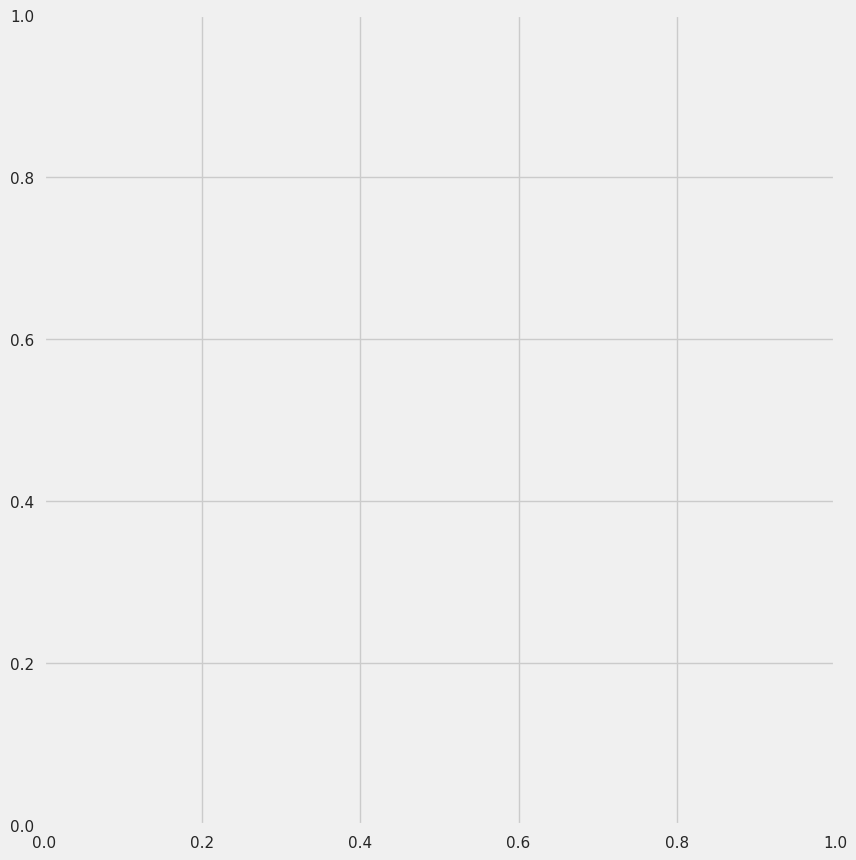

In [37]:
AV.AutoViz(path)

###c. How to explore relationships and patterns in the data.

---


* AutoViz strives to automatically discover connections and patterns in data. It produces visualisations of your dataset's associations, trends, and other patterns. Therefore, we can explore relationship and patterns in the data simultaneously when generating basic statistics and visualization.

### d. Any unique features or capabilities of each tool that you find noteworthy.

---



* Automatic Visualization
> AutoViz is particularly excellent at automating the process of producing visualisations for a given dataset. AutoViz dynamically selects appropriate visualisations based on the data types of the columns, so you don't have to define the type of chart for each variable.
* Minimal Code Requirement
> AutoViz eliminates the need for substantial EDA coding. You may produce a wide range of visualisations and acquire preliminary insights into your dataset with just a few lines of code.
* Support Various Data Types
> AutoViz can work with a variety of data types, such as numeric, categorical, date, and boolean variables. It changes its visualisation strategy according to the nature of the data, allowing flexibility for various dataset kinds.















## Pros and Cons Analysis:


---



### AutoViz:

#### Pros

*   Automation: AutoViz excels in automating the visualisation process, making it quick and simple for people that don't have extensive coding or visualisation knowledge.

*   Handles huge Datasets: It is designed to efficiently handle enormous datasets, providing an overview even for large volumes of data.


*   Interactive Visualizations: AutoViz can generate interactive visualisations for web-based settings, which improves the user experience.

#### Cons


*   Limited Customization: While AutoViz is great for rapid exploration, it may lack the customization options offered by other libraries for users who require greater control over specific visualisations.


*   Dependency on Data Types: Because the tool primarily selects visualisations automatically based on data types, it may not always be suitable for the user's needs or tastes.









### Other EDA Tools (e.g., Matplotlib, Seaborn, Plotly, Pandas Visualization):

#### Pros

*   Flexibility and Customization: Users can develop specialised visualisations that are suited to their needs thanks to the great degree of flexibility and customization offered by these tools.


*  Extensive Chart Types: Matplotlib, Seaborn, Plotly, and Pandas support a wide range of chart types, including advanced and specialized visualizations.


*   Integration with Other Libraries: These tools frequently offer a smooth workflow when combined with other machine learning and data science libraries.


#### Cons


*   Learning Curve: Users who are unfamiliar with programming or data visualisation may find using these libraries to have a more challenging learning curve.



*   Manual Specification: Unlike AutoViz's automatic technique, users may need to specifically select the type of chart for each variable, which can be time-consuming.


### Insight:

*   With its automated insights, AutoViz is effective at handling massive datasets and conducting rapid preliminary studies. More flexible traditional EDA tools, such as Matplotlib and Seaborn, provide intricate customizations and customised visualisations. The objectives and characteristics of the dataset determine each tool's performance. It is advised to use both techniques on the dataset for specific evaluation, taking into account variables like dataset size, complexity, and the necessity for quick versus thorough studies.




## Conclusion:

---



When used in conjunction with the dataset that we choose, AutoViz is effective at managing huge datasets and doing quick analyses, delivering automatic insights without requiring a lot of manual code. Traditional EDA tools, such as those for deep analyses or specialised chart types, such as Matplotlib, Seaborn, Plotly, and Pandas, provide greater customization and control over certain visualisations. The analysis aims, dataset size, and user experience all influence which option is best. An all-encompassing exploration strategy for the our dataset might be provided via a hybrid method that starts with AutoViz for fast insights and moves to standard tools for customisation.
